In [1]:
import torch
from torch import nn

import torchvision
from torchvision import datasets, transforms

import matplotlib.pyplot as plt
import numpy as np

import torchvision.utils as vutils

In [33]:
BATCH_SIZE = 20

TRAIN_DIR = "../../data/frame_maker/Winnie_the_Pooh_1"
TEST_DIR = "../../data/frame_maker/test_1"

In [3]:
class ImageFolderWithPaths(datasets.ImageFolder):
    """Custom dataset that includes image file paths. Extends
    torchvision.datasets.ImageFolder
    """

    # override the __getitem__ method. this is the method that dataloader calls
    def __getitem__(self, index):
        # this is what ImageFolder normally returns 
        original_tuple = super(ImageFolderWithPaths, self).__getitem__(index)
        # the image file path
        path = self.imgs[index][0]
        # make a new tuple that includes original and the path
        tuple_with_path = (original_tuple + (path,))
        return tuple_with_path

In [4]:
transform = transforms.Compose([
    transforms.CenterCrop(512),
    transforms.Resize(255),
    transforms.ToTensor()
])

def get_loader(path, batch_size=1):
    dataset = ImageFolderWithPaths(
        root=path,
        transform=transform,
        
    )
    
    dataloader = torch.utils.data.DataLoader(
        dataset,
        batch_size=batch_size
    )
    
    return dataloader

In [5]:
dataset = get_loader(TRAIN_DIR, BATCH_SIZE)
test_dataset = get_loader(TEST_DIR, 3)

tensor(0.8039)
tensor(0.)


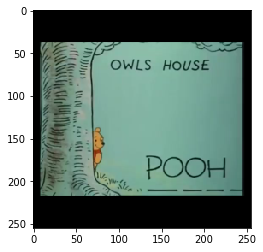

In [6]:
sample = next(iter(dataset))

print (sample[0][0].max())
print (sample[0][0].min())

plt.imshow(np.transpose(sample[0][0].numpy(), (1, 2, 0)))

In [7]:
class FrameMaker(nn.Module):
    def __init__(self, ic=6, channels=(32, 64, 64, 32), kernels=(4, 4, 4, 4)):
        super(FrameMaker, self).__init__()
        
        conv_layers = []
        
        in_ch = ic
        for c, k in zip(channels, kernels):
            conv_layers.append(nn.Conv2d(in_ch, c, k))
            conv_layers.append(nn.BatchNorm2d(c))
            conv_layers.append(nn.ReLU())
            conv_layers.append(nn.MaxPool2d(2))
        
            in_ch = c
        
        self.conv = nn.Sequential(*conv_layers)
        
        t_conv_layers = []
        
        for c, k in zip(reversed(channels), reversed(kernels)):
            t_conv_layers.append(nn.ConvTranspose2d(in_ch, c, (k+1), 2))
            t_conv_layers.append(nn.BatchNorm2d(c))
            t_conv_layers.append(nn.ReLU())
        
            in_ch = c
            
        t_conv_layers.append(nn.ConvTranspose2d(in_ch, 3, 3, 1))
        t_conv_layers.append(nn.Tanh())
            
        self.t_conv = nn.Sequential(*t_conv_layers)
        
    def forward(self, x):
        conv_output = self.conv(x)
        t_conv_output = self.t_conv(conv_output)
        
        return t_conv_output

In [25]:
class Discriminator(nn.Module):
    def __init__(self, ic=9, channels=(32, 64, 64, 32, 16), kernels=(3, 3, 3, 3, 3)):
        super(Discriminator, self).__init__()
        layers = []

        # state size. (ndf) x 32 x 32
        icn = ic
        for c, k in zip(channels, kernels):
            layers.append(nn.Conv2d(icn, c, k, 2, bias=False))
            layers.append(nn.BatchNorm2d(c))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            icn = c

        layers.append(nn.Conv2d(icn, 1, 7, 1, 0, bias=False))
        layers.append(nn.Sigmoid())
        
#         self.nn_layers = nn.ModuleList(layers)
        self.main = nn.Sequential(*layers)

    def forward(self, input, label):
        x = torch.cat((input, label), dim=1)
        
#         for layer in self.nn_layers:
#             x = layer(x)
#             print(x.shape)
        return self.main(x)

In [26]:
model = FrameMaker()
model.cuda()

discriminator = Discriminator()
discriminator.cuda()

criterion = nn.BCELoss()
optimizer = torch.optim.Adam(model.parameters())
disc_optimizer = torch.optim.Adam(discriminator.parameters())

In [10]:
def combine_images(start_idx, data):
    left = (data.shape[0]-start_idx) % 4
    if left > 0:
        data = data[:-left]
    raw_x = data[start_idx::2, :]
    x = raw_x.reshape(-1, 6, 255, 255)
    y = data[start_idx::4, :]
    return x, y

def get_combined_images(data):
    x0, y0 = combine_images(0, data)
    x1, y1 = combine_images(1, data)
    x2, y2 = combine_images(2, data)
    x3, y3 = combine_images(3, data)
    
    combine_x = torch.cat([x0, x1, x2, x3])
    combine_y = torch.cat([y0, y1, y2, y3])
    
    return combine_x.cuda(), combine_y.cuda()

In [39]:
def get_result(model, results):
    result = []
    for data, _, names in test_dataset:
        if data.shape[0] < 3:
            break
            
        combine_data = data[[0, 2]].reshape(1, 6, 255, 255)

        est_y = model(combine_data.cuda())

        real = np.transpose(vutils.make_grid(data, padding=2, normalize=True).cpu(),(1,2,0))
        estimate = np.transpose(vutils.make_grid([data[0], est_y[0].cpu().detach(), data[2]], padding=2, normalize=True).cpu(),(1,2,0))
        result.append((real, estimate))
    
    results.append(result)

In [ ]:
# GAN style
EPOCHS = 50
results = []

for epoch in range(EPOCHS):
    print("epoch {}".format(epoch))
    losses = []
    
    for itr, (data, _, names) in enumerate(dataset):
        x, y = get_combined_images(data)

        disc_optimizer.zero_grad()
        output = discriminator(x, y)
        loss = criterion(output, torch.ones_like(output))
        loss.backward()
        disc_optimizer.step()
        
        # generate frame
        est_y = model(x)

#         disc_optimizer.zero_grad()
        output = discriminator(x, est_y.detach())
        loss = criterion(output, torch.zeros_like(output))
        loss.backward()
        disc_optimizer.step()
        
        #  print("\titeration {}".format(itr))
        optimizer.zero_grad()
        output = discriminator(x, est_y)
        loss = criterion(output, torch.ones_like(output))
        loss.backward()
        optimizer.step()
        
        losses.append(loss.item())
    
    print("loss: {}".format(np.mean(losses)))
#     print("save estimations")
    get_result(model, results)

In [40]:
EPOCHS = 50

results = []

for epoch in range(EPOCHS):
    print("epoch {}".format(epoch))
    losses = []
    
    for itr, (data, _, names) in enumerate(dataset):
#         print("\titeration {}".format(itr))
        optimizer.zero_grad()

        x, y = get_combined_images(data)
        est_y = model(x)
        loss = criterion(est_y, y)
        losses.append(loss.item())
        loss.backward()
        optimizer.step()
    
    print("loss: {}".format(np.mean(losses)))
#     print("save estimations")
    get_result(model, results)

epoch 0
loss: 5.981928232135159
epoch 1
loss: 6.085943009151091
epoch 2
loss: 7.12720795197062
epoch 3
loss: 9.69157098543526
epoch 4
loss: 5.424660263749042
epoch 5
loss: 7.724005821907874
epoch 6
loss: 9.245864240249785
epoch 7
loss: 5.53667238055922
epoch 8
loss: 7.393970201511194
epoch 9
loss: 8.812291246829647
epoch 10
loss: 10.706663675827555
epoch 11
loss: 9.717302940859653
epoch 12
loss: 9.519809413664412
epoch 13
loss: 10.311254227515494
epoch 14
loss: 10.465235514215903
epoch 15
loss: 10.481000118916578
epoch 16
loss: 11.215674626945269
epoch 17
loss: 10.576969991816153
epoch 18
loss: 11.159066691256985
epoch 19
loss: 11.303508406818503
epoch 20
loss: 12.0053499996072
epoch 21
loss: 11.854902173032855
epoch 22
loss: 12.624525391229309
epoch 23
loss: 12.626860949072507
epoch 24
loss: 12.89182971255614
epoch 25
loss: 13.333715117803894
epoch 26
loss: 13.646556528488007
epoch 27
loss: 13.912133391540829
epoch 28
loss: 13.963223745327184
epoch 29
loss: 14.343428139639373
epoch 30

C:\Users\esoot\Miniconda3\envs\ml\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


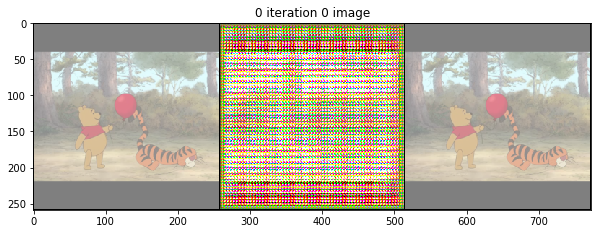

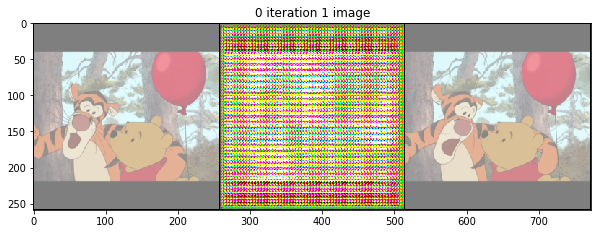

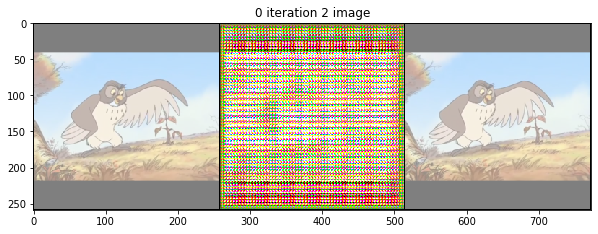

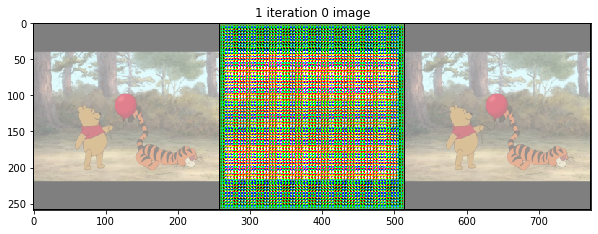

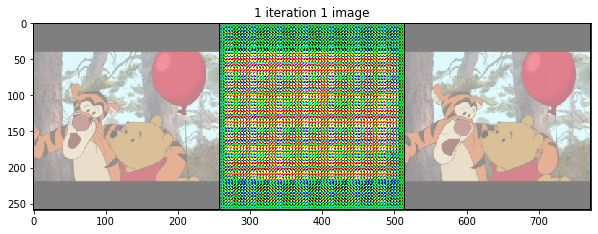

...

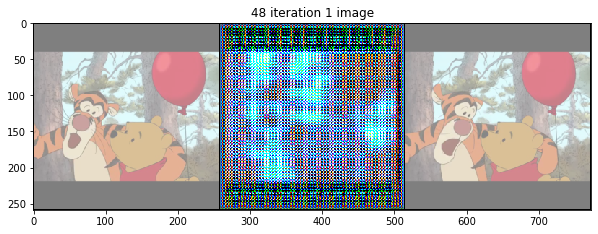

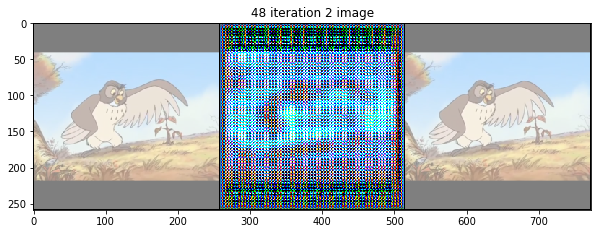

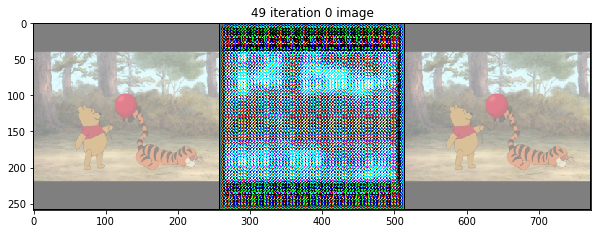

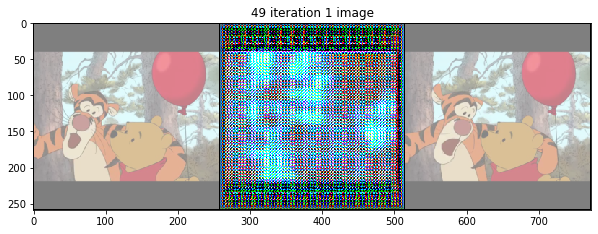

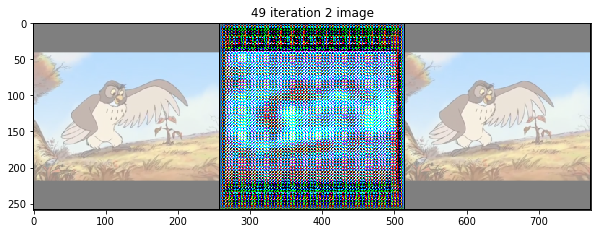

In [41]:
for itr, result in enumerate(results):
    for idx, output in enumerate(result):
        plt.figure(figsize=(10, 5))
        plt.title("{} iteration {} image".format(itr, idx))
        plt.imshow(output[1])